In [55]:
import numpy as np # library to handle data in a vectorized manner

import pandas as pd # library for data analsysis
pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', None)

import json # library to handle JSON files

from geopy.geocoders import Nominatim # convert an address into latitude and longitude values

import requests # library to handle requests
from pandas.io.json import json_normalize # tranform JSON file into a pandas dataframe

# Matplotlib and associated plotting modules
import matplotlib.cm as cm
import matplotlib.colors as colors
import matplotlib.pyplot as plt

# import k-means from clustering stage
from sklearn.cluster import KMeans

!pip install folium

import folium # map rendering library

print('Libraries imported.')

Libraries imported.


# New York

In [4]:
!wget -q -O 'newyork_data.json' https://cf-courses-data.s3.us.cloud-object-storage.appdomain.cloud/IBMDeveloperSkillsNetwork-DS0701EN-SkillsNetwork/labs/newyork_data.json
print('Data downloaded!')
with open('newyork_data.json') as json_data:
    newyork_data = json.load(json_data)

Data downloaded!


In [5]:
neighborhoods_data = newyork_data['features']

In [6]:
# define the dataframe columns
column_names = ['Borough', 'Neighborhood', 'Latitude', 'Longitude'] 

# instantiate the dataframe
neighborhoods = pd.DataFrame(columns=column_names)

In [7]:
for data in neighborhoods_data:
    borough = neighborhood_name = data['properties']['borough'] 
    neighborhood_name = data['properties']['name']
        
    neighborhood_latlon = data['geometry']['coordinates']
    neighborhood_lat = neighborhood_latlon[1]
    neighborhood_lon = neighborhood_latlon[0]
    
    neighborhoods = neighborhoods.append({'Borough': borough,
                                          'Neighborhood': neighborhood_name,
                                          'Latitude': neighborhood_lat,
                                          'Longitude': neighborhood_lon}, ignore_index=True)

In [8]:
address = 'New York City, NY'

geolocator = Nominatim(user_agent="ny_explorer")
location = geolocator.geocode(address)
latitude = location.latitude
longitude = location.longitude
print('The geograpical coordinate of New York City are {}, {}.'.format(latitude, longitude))

The geograpical coordinate of New York City are 40.7127281, -74.0060152.


In [9]:
# create map of New York using latitude and longitude values
map_newyork = folium.Map(location=[latitude, longitude], zoom_start=10)

# add markers to map
for lat, lng, borough, neighborhood in zip(neighborhoods['Latitude'], neighborhoods['Longitude'], neighborhoods['Borough'], neighborhoods['Neighborhood']):
    label = '{}, {}'.format(neighborhood, borough)
    label = folium.Popup(label, parse_html=True)
    folium.CircleMarker(
        [lat, lng],
        radius=5,
        popup=label,
        color='red',
        fill=True,
        fill_color='red',
        fill_opacity=0.7,
        parse_html=False).add_to(map_newyork)  
    
map_newyork

In [195]:
CLIENT_ID = 'LZGRHEEI0OUADKEID4TDLIUXEKQXEHSWLWDM4ZDZTDPLUR4E' # your Foursquare ID
CLIENT_SECRET = 'YT0WAMF3YZK2Z5PHRVUHE11IR5PRQ5VEVUZEQIZO3T1QTI1T' # your Foursquare Secret
ACCESS_TOKEN = 'B5PPEH5ZNS3AYHJVZG0RTOVZH3SVE2EI0YDCBKE4DD5IUVQK' # your FourSquare Access Token
VERSION = '20180604'
LIMIT = 30
print('Your credentails:')
print('CLIENT_ID: ' + CLIENT_ID)
print('CLIENT_SECRET:' + CLIENT_SECRET)

Your credentails:
CLIENT_ID: LZGRHEEI0OUADKEID4TDLIUXEKQXEHSWLWDM4ZDZTDPLUR4E
CLIENT_SECRET:YT0WAMF3YZK2Z5PHRVUHE11IR5PRQ5VEVUZEQIZO3T1QTI1T


In [196]:
neighborhood_latitude = neighborhoods.loc[0, 'Latitude'] # neighborhood latitude value
neighborhood_longitude = neighborhoods.loc[0, 'Longitude'] # neighborhood longitude value

neighborhood_name = neighborhoods.loc[0, 'Neighborhood'] # neighborhood name

print('Latitude and longitude values of {} are {}, {}.'.format(neighborhood_name, 
                                                               neighborhood_latitude, 
                                                               neighborhood_longitude))

Latitude and longitude values of Wakefield are 40.89470517661, -73.84720052054902.


In [197]:
LIMIT=5
radius=500
url='https://api.foursquare.com/v2/venues/explore?&client_id={}&client_secret{}&v={}&LL={},{}&radius={}&limit={}'.format(
CLIENT_ID,
CLIENT_SECRET,
VERSION,
neighborhood_latitude,
neighborhood_longitude,
radius,
LIMIT)
url

'https://api.foursquare.com/v2/venues/explore?&client_id=LZGRHEEI0OUADKEID4TDLIUXEKQXEHSWLWDM4ZDZTDPLUR4E&client_secretYT0WAMF3YZK2Z5PHRVUHE11IR5PRQ5VEVUZEQIZO3T1QTI1T&v=20180604&LL=40.89470517661,-73.84720052054902&radius=500&limit=5'

In [198]:
results = requests.get(url).json()
results

{'meta': {'code': 400,
  'errorType': 'invalid_auth',
  'errorDetail': 'Missing access credentials. See https://developer.foursquare.com/docs/api/configuration/authentication for details.',
  'requestId': '601639d41ed4402a42a5eecb'},
 'response': {}}

In [199]:
def getNearbyVenues(names, latitudes, longitudes, radius=500):
    
    venues_list=[]
    for name, lat, lng in zip(names, latitudes, longitudes):
        print(name)
            
        # create the API request URL
        url = 'https://api.foursquare.com/v2/venues/explore?&client_id={}&client_secret={}&v={}&ll={},{}&radius={}&limit={}'.format(
            CLIENT_ID, 
            CLIENT_SECRET, 
            VERSION, 
            lat, 
            lng, 
            radius, 
            LIMIT)
            
        # make the GET request
        results = requests.get(url).json()["response"]['groups'][0]['items']
        
        # return only relevant information for each nearby venue
        venues_list.append([(
            name, 
            lat, 
            lng, 
            v['venue']['name'], 
            v['venue']['location']['lat'], 
            v['venue']['location']['lng'],  
            v['venue']['categories'][0]['name']) for v in results])

    nearby_venues = pd.DataFrame([item for venue_list in venues_list for item in venue_list])
    nearby_venues.columns = ['Neighbourhood', 
                  'Neighborhood Latitude', 
                  'Neighborhood Longitude', 
                  'Venue', 
                  'Venue Latitude', 
                  'Venue Longitude', 
                  'Venue Category']
    
    return(nearby_venues)

In [200]:
newyork_venues=getNearbyVenues(names=neighborhoods['Neighborhood'],latitudes=neighborhoods['Latitude'],
                                longitudes=neighborhoods['Longitude'])

Wakefield
Co-op City
Eastchester
Fieldston
Riverdale
Kingsbridge
Marble Hill
Woodlawn
Norwood
Williamsbridge
Baychester
Pelham Parkway
City Island
Bedford Park
University Heights
Morris Heights
Fordham
East Tremont
West Farms
High  Bridge
Melrose
Mott Haven
Port Morris
Longwood
Hunts Point
Morrisania
Soundview
Clason Point
Throgs Neck
Country Club
Parkchester
Westchester Square
Van Nest
Morris Park
Belmont
Spuyten Duyvil
North Riverdale
Pelham Bay
Schuylerville
Edgewater Park
Castle Hill
Olinville
Pelham Gardens
Concourse
Unionport
Edenwald
Bay Ridge
Bensonhurst
Sunset Park
Greenpoint
Gravesend
Brighton Beach
Sheepshead Bay
Manhattan Terrace
Flatbush
Crown Heights
East Flatbush
Kensington
Windsor Terrace
Prospect Heights
Brownsville
Williamsburg
Bushwick
Bedford Stuyvesant
Brooklyn Heights
Cobble Hill
Carroll Gardens
Red Hook
Gowanus
Fort Greene
Park Slope
Cypress Hills
East New York
Starrett City
Canarsie
Flatlands
Mill Island
Manhattan Beach
Coney Island
Bath Beach
Borough Park
Dyker

In [201]:
print('{} venues were returned by Foursquare.'.format(newyork_venues.shape[0]))
newyork_venues.head()

1476 venues were returned by Foursquare.


,Neighbourhood,Neighborhood Latitude,Neighborhood Longitude,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Wakefield,40.894705,-73.847201,Lollipops Gelato,40.894123,-73.845892,Dessert Shop
1,Wakefield,40.894705,-73.847201,Carvel Ice Cream,40.890487,-73.848568,Ice Cream Shop
2,Wakefield,40.894705,-73.847201,Walgreens,40.896528,-73.844700,Pharmacy
3,Wakefield,40.894705,-73.847201,Rite Aid,40.896649,-73.844846,Pharmacy
4,Wakefield,40.894705,-73.847201,Dunkin',40.890459,-73.849089,Donut Shop


In [202]:
newyork_venues.groupby('Neighbourhood').count()

,Neighborhood Latitude,Neighborhood Longitude,Venue,Venue Latitude,Venue Longitude,Venue Category
Neighbourhood,,,,,,
Allerton,5,5,5,5,5,5
Annadale,5,5,5,5,5,5
Arden Heights,5,5,5,5,5,5
Arlington,4,4,4,4,4,4
Arrochar,5,5,5,5,5,5
Arverne,5,5,5,5,5,5
Astoria,5,5,5,5,5,5
Astoria Heights,5,5,5,5,5,5
Auburndale,5,5,5,5,5,5


In [203]:
# one hot encoding
newyork_onehot = pd.get_dummies(newyork_venues[['Venue Category']], prefix="", prefix_sep="")

# add neighborhood column back to dataframe
newyork_onehot['Neighbourhood'] = newyork_venues['Neighbourhood'] 

# move neighborhood column to the first column
fixed_columns = [newyork_onehot.columns[-1]] + list(newyork_onehot.columns[:-1])
newyork_onehot = newyork_onehot[fixed_columns]

newyork_onehot

,Neighbourhood,ATM,Accessories Store,Adult Boutique,Afghan Restaurant,African Restaurant,American Restaurant,Antique Shop,Arcade,Arepa Restaurant,Argentinian Restaurant,Art Gallery,Art Museum,Arts & Crafts Store,Asian Restaurant,Athletics & Sports,Auto Garage,BBQ Joint,Bagel Shop,Bakery,Bank,Bar,Baseball Field,Baseball Stadium,Basketball Court,Beach,Beer Bar,Beer Garden,Beer Store,Big Box Store,Bistro,Boat or Ferry,Bookstore,Boutique,Bowling Alley,Boxing Gym,Brazilian Restaurant,Breakfast Spot,Brewery,Bridge,Bubble Tea Shop,Burger Joint,Burrito Place,Bus Line,Bus Station,Bus Stop,Business Service,Butcher,Café,Cajun / Creole Restaurant,Campground,Candy Store,Caribbean Restaurant,Casino,Chinese Restaurant,Christmas Market,Circus,Climbing Gym,Clothing Store,Cocktail Bar,Coffee Shop,College Academic Building,College Basketball Court,Comedy Club,Construction & Landscaping,Convenience Store,Cooking School,Cosmetics Shop,Cuban Restaurant,Cupcake Shop,Cycle Studio,Dance Studio,Deli / Bodega,Dessert Shop,Dim Sum Restaurant,Diner,Discount Store,Distillery,Dive Bar,Doctor's Office,Dog Run,Donut Shop,Dosa Place,Dumpling Restaurant,Duty-free Shop,Eastern European Restaurant,Empanada Restaurant,Event Service,Event Space,Factory,Falafel Restaurant,Farm,Farmers Market,Fast Food Restaurant,Field,Filipino Restaurant,Fish & Chips Shop,Fish Market,Flea Market,Flower Shop,Food,Food & Drink Shop,Food Court,Food Truck,French Restaurant,Fried Chicken Joint,Frozen Yogurt Shop,Fruit & Vegetable Store,Furniture / Home Store,Gas Station,Gastropub,General Entertainment,Gift Shop,Golf Course,Gourmet Shop,Greek Restaurant,Grocery Store,Gym,Gym / Fitness Center,Halal Restaurant,Harbor / Marina,Hawaiian Restaurant,Health & Beauty Service,Health Food Store,Historic Site,History Museum,Home Service,Hookah Bar,Hostel,Hotel,Hotel Bar,Ice Cream Shop,Indian Restaurant,Indie Movie Theater,Intersection,Irish Pub,Israeli Restaurant,Italian Restaurant,Japanese Curry Restaurant,Japanese Restaurant,Jazz Club,Jewelry Store,Juice Bar,Karaoke Bar,Korean Restaurant,Latin American Restaurant,Lawyer,Liquor Store,Lounge,Malay Restaurant,Market,Martial Arts School,Mediterranean Restaurant,Men's Store,Mexican Restaurant,Middle Eastern Restaurant,Miscellaneous Shop,Mobile Phone Shop,Molecular Gastronomy Restaurant,Monument / Landmark,Moroccan Restaurant,Movie Theater,Moving Target,Museum,Music Venue,Nail Salon,Neighborhood,New American Restaurant,Nightclub,Nightlife Spot,Noodle House,Opera House,Optical Shop,Other Great Outdoors,Other Nightlife,Other Repair Shop,Outdoor Sculpture,Outdoors & Recreation,Paper / Office Supplies Store,Park,Performing Arts Venue,Peruvian Restaurant,Pet Café,Pet Store,Pharmacy,Pier,Pilates Studio,Pizza Place,Playground,Plaza,Polish Restaurant,Pool,Post Office,Pub,Puerto Rican Restaurant,Ramen Restaurant,Recording Studio,Recreation Center,Rental Car Location,Rest Area,Restaurant,River,Rock Club,Russian Restaurant,Salad Place,Salon / Barbershop,Sandwich Place,Scandinavian Restaurant,Scenic Lookout,Seafood Restaurant,Shipping Store,Shoe Store,Shop & Service,Shopping Mall,Skate Park,Skating Rink,Smoke Shop,Snack Place,Soup Place,South American Restaurant,Southern / Soul Food Restaurant,Spa,Spanish Restaurant,Speakeasy,Sporting Goods Shop,Sports Bar,Sports Club,Sri Lankan Restaurant,Steakhouse,Storage Facility,Supermarket,Surf Spot,Sushi Restaurant,Taco Place,Tapas Restaurant,Tattoo Parlor,Tea Room,Tennis Court,Tennis Stadium,Thai Restaurant,Theater,Theme Park,Thrift / Vintage Store,Tibetan Restaurant,Trail,Train Station,Turkish Restaurant,Vegetarian / Vegan Restaurant,Video Game Store,Vietnamese Restaurant,Waterfront,Whisky Bar,Wine Bar,Wine Shop,Wings Joint,Yoga Studio
0,Wakefield,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,

In [204]:
newyork_grouped = newyork_onehot.groupby('Neighbourhood').mean().reset_index()
newyork_grouped

,Neighbourhood,ATM,Accessories Store,Adult Boutique,Afghan Restaurant,African Restaurant,American Restaurant,Antique Shop,Arcade,Arepa Restaurant,Argentinian Restaurant,Art Gallery,Art Museum,Arts & Crafts Store,Asian Restaurant,Athletics & Sports,Auto Garage,BBQ Joint,Bagel Shop,Bakery,Bank,Bar,Baseball Field,Baseball Stadium,Basketball Court,Beach,Beer Bar,Beer Garden,Beer Store,Big Box Store,Bistro,Boat or Ferry,Bookstore,Boutique,Bowling Alley,Boxing Gym,Brazilian Restaurant,Breakfast Spot,Brewery,Bridge,Bubble Tea Shop,Burger Joint,Burrito Place,Bus Line,Bus Station,Bus Stop,Business Service,Butcher,Café,Cajun / Creole Restaurant,Campground,Candy Store,Caribbean Restaurant,Casino,Chinese Restaurant,Christmas Market,Circus,Climbing Gym,Clothing Store,Cocktail Bar,Coffee Shop,College Academic Building,College Basketball Court,Comedy Club,Construction & Landscaping,Convenience Store,Cooking School,Cosmetics Shop,Cuban Restaurant,Cupcake Shop,Cycle Studio,Dance Studio,Deli / Bodega,Dessert Shop,Dim Sum Restaurant,Diner,Discount Store,Distillery,Dive Bar,Doctor's Office,Dog Run,Donut Shop,Dosa Place,Dumpling Restaurant,Duty-free Shop,Eastern European Restaurant,Empanada Restaurant,Event Service,Event Space,Factory,Falafel Restaurant,Farm,Farmers Market,Fast Food Restaurant,Field,Filipino Restaurant,Fish & Chips Shop,Fish Market,Flea Market,Flower Shop,Food,Food & Drink Shop,Food Court,Food Truck,French Restaurant,Fried Chicken Joint,Frozen Yogurt Shop,Fruit & Vegetable Store,Furniture / Home Store,Gas Station,Gastropub,General Entertainment,Gift Shop,Golf Course,Gourmet Shop,Greek Restaurant,Grocery Store,Gym,Gym / Fitness Center,Halal Restaurant,Harbor / Marina,Hawaiian Restaurant,Health & Beauty Service,Health Food Store,Historic Site,History Museum,Home Service,Hookah Bar,Hostel,Hotel,Hotel Bar,Ice Cream Shop,Indian Restaurant,Indie Movie Theater,Intersection,Irish Pub,Israeli Restaurant,Italian Restaurant,Japanese Curry Restaurant,Japanese Restaurant,Jazz Club,Jewelry Store,Juice Bar,Karaoke Bar,Korean Restaurant,Latin American Restaurant,Lawyer,Liquor Store,Lounge,Malay Restaurant,Market,Martial Arts School,Mediterranean Restaurant,Men's Store,Mexican Restaurant,Middle Eastern Restaurant,Miscellaneous Shop,Mobile Phone Shop,Molecular Gastronomy Restaurant,Monument / Landmark,Moroccan Restaurant,Movie Theater,Moving Target,Museum,Music Venue,Nail Salon,Neighborhood,New American Restaurant,Nightclub,Nightlife Spot,Noodle House,Opera House,Optical Shop,Other Great Outdoors,Other Nightlife,Other Repair Shop,Outdoor Sculpture,Outdoors & Recreation,Paper / Office Supplies Store,Park,Performing Arts Venue,Peruvian Restaurant,Pet Café,Pet Store,Pharmacy,Pier,Pilates Studio,Pizza Place,Playground,Plaza,Polish Restaurant,Pool,Post Office,Pub,Puerto Rican Restaurant,Ramen Restaurant,Recording Studio,Recreation Center,Rental Car Location,Rest Area,Restaurant,River,Rock Club,Russian Restaurant,Salad Place,Salon / Barbershop,Sandwich Place,Scandinavian Restaurant,Scenic Lookout,Seafood Restaurant,Shipping Store,Shoe Store,Shop & Service,Shopping Mall,Skate Park,Skating Rink,Smoke Shop,Snack Place,Soup Place,South American Restaurant,Southern / Soul Food Restaurant,Spa,Spanish Restaurant,Speakeasy,Sporting Goods Shop,Sports Bar,Sports Club,Sri Lankan Restaurant,Steakhouse,Storage Facility,Supermarket,Surf Spot,Sushi Restaurant,Taco Place,Tapas Restaurant,Tattoo Parlor,Tea Room,Tennis Court,Tennis Stadium,Thai Restaurant,Theater,Theme Park,Thrift / Vintage Store,Tibetan Restaurant,Trail,Train Station,Turkish Restaurant,Vegetarian / Vegan Restaurant,Video Game Store,Vietnamese Restaurant,Waterfront,Whisky Bar,Wine Bar,Wine Shop,Wings Joint,Yoga Studio
0,Allerton,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.00,0.00,0.00,0.0,0.00,0.0,0.0,0.00,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.00,0.000000,0.0,0.0,0.00,0.00,0.0,0.0,0.00,0.0,0.0,0.00,0.00,0.000000,0.0,0.0,0.0,0.0,0.00,0.0,0.0,0.0,

In [205]:
num_top_venues = 5

for hood in newyork_grouped['Neighbourhood']:
    print("----"+hood+"----")
    temp = newyork_grouped[newyork_grouped['Neighbourhood'] == hood].T.reset_index()
    temp.columns = ['venue','freq']
    temp = temp.iloc[1:]
    temp['freq'] = temp['freq'].astype(float)
    temp = temp.round({'freq': 2})
    print(temp.sort_values('freq', ascending=False).reset_index(drop=True).head(num_top_venues))
    print('\n')

----Allerton----
                  venue  freq
0            Donut Shop   0.2
1           Pizza Place   0.2
2  Fast Food Restaurant   0.2
3   Martial Arts School   0.2
4          Dessert Shop   0.2


----Annadale----
                 venue  freq
0           Restaurant   0.2
1  American Restaurant   0.2
2        Train Station   0.2
3                Diner   0.2
4               Bakery   0.2


----Arden Heights----
         venue  freq
0       Lawyer   0.2
1  Coffee Shop   0.2
2  Pizza Place   0.2
3     Pharmacy   0.2
4  Flower Shop   0.2


----Arlington----
                 venue  freq
0         Intersection  0.25
1  American Restaurant  0.25
2        Boat or Ferry  0.25
3        Deli / Bodega  0.25
4                  ATM  0.00


----Arrochar----
                   venue  freq
0     Italian Restaurant   0.4
1            Pizza Place   0.2
2  Outdoors & Recreation   0.2
3      Polish Restaurant   0.2
4                 Museum   0.0


----Arverne----
             venue  freq
0        Surf Spot

In [206]:
def return_most_common_venues(row, num_top_venues):
    row_categories = row.iloc[1:]
    row_categories_sorted = row_categories.sort_values(ascending=False)
    
    return row_categories_sorted.index.values[0:num_top_venues]

In [207]:
num_top_venues = 10

indicators = ['st', 'nd', 'rd']

# create columns according to number of top venues
columns = ['Neighbourhood']
for ind in np.arange(num_top_venues):
    try:
        columns.append('{}{} Most Common Venue'.format(ind+1, indicators[ind]))
    except:
        columns.append('{}th Most Common Venue'.format(ind+1))

# create a new dataframe
ny_venues_sorted = pd.DataFrame(columns=columns)
ny_venues_sorted['Neighbourhood'] = newyork_grouped['Neighbourhood']

for ind in np.arange(newyork_grouped.shape[0]):
    ny_venues_sorted.iloc[ind, 1:] = return_most_common_venues(newyork_grouped.iloc[ind, :], num_top_venues)

ny_venues_sorted.head()

,Neighbourhood,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue
0,Allerton,Fast Food Restaurant,Pizza Place,Dessert Shop,Martial Arts School,Donut Shop,Falafel Restaurant,Factory,Event Space,Dog Run,Farm
1,Annadale,Bakery,Train Station,Diner,American Restaurant,Restaurant,Donut Shop,Dosa Place,Dumpling Restaurant,Duty-free Shop,Eastern European Restaurant
2,Arden Heights,Lawyer,Pizza Place,Coffee Shop,Pharmacy,Flower Shop,Yoga Studio,Empanada Restaurant,Dosa Place,Dumpling Restaurant,Duty-free Shop
3,Arlington,Deli / Bodega,Boat or Ferry,American Restaurant,Intersection,Factory,Duty-free Shop,Eastern European Restaurant,Empanada Restaurant,Event Service,Event Space
4,Arrochar,Italian Restaurant,Polish Restaurant,Pizza Place,Outdoors & Recreation,Eastern European Restaurant,Donut Shop,Dosa Place,Dumpling Restaurant,Duty-free Shop,Empanada Restaurant


In [208]:
# set number of clusters
kclusters = 5

newyork_grouped_clustering = newyork_grouped.drop('Neighbourhood', 1)

# run k-means clustering
kmeans = KMeans(n_clusters=kclusters, random_state=0).fit(newyork_grouped_clustering)

# check cluster labels generated for each row in the dataframe
kmeans.labels_[0:10] 

array([3, 0, 3, 0, 3, 4, 0, 3, 0, 2], dtype=int32)

In [218]:
# add clustering labels
ny_venues_sorted.insert(0, 'Cluster Labels2', kmeans.labels_)

ny_merged = newyork_venues

# merge manhattan_grouped with manhattan_data to add latitude/longitude for each neighborhood
ny_merged = ny_merged.join(ny_venues_sorted.set_index('Neighbourhood'), on='Neighbourhood')

ny_merged.head() 

ValueError: cannot insert Cluster Labels2, already exists

In [213]:
map_clusters = folium.Map(location=[latitude, longitude], zoom_start=11)

# set color scheme for the clusters
x = np.arange(kclusters)
ys = [i + x + (i*x)**2 for i in range(kclusters)]
colors_array = cm.rainbow(np.linspace(0, 1, len(ys)))
rainbow = [colors.rgb2hex(i) for i in colors_array]

# add markers to the map
markers_colors = []
for lat, lon, poi, cluster in zip(neighborhoods['Latitude'], neighborhoods['Longitude'], neighborhoods['Neighborhood'], neighborhoods['Cluster Labels']):
    label = folium.Popup(str(poi) + ' Cluster ' + str(cluster), parse_html=True)
    folium.CircleMarker(
        [lat, lon],
        radius=5,
        popup=label,
        color=rainbow[cluster-1],
        fill=True,
        fill_color=rainbow[cluster-1],
        fill_opacity=0.7).add_to(map_clusters)
       
map_clusters

KeyError: 'Cluster Labels'

In [45]:
# The code was removed by Watson Studio for sharing.

,Offense,2017,2018,2019
0,Murder,292,295,319
1,Rape,1449,1794,1755
2,Robbery,15500,12913,13371
3,Felony Assault,20847,20208,20698
4,Burglary,12990,11687,10783


In [72]:
ny_crime.rename(columns={'Offense':'Offense'},inplace=True)
#ny_crime.set_index('Offense',inplace=True)
ny_crime

,2017,2018,2019
Offense,,,
Murder,292,295,319
Rape,1449,1794,1755
Robbery,15500,12913,13371
Felony Assault,20847,20208,20698
Burglary,12990,11687,10783
Grand Larceny,44279,43558,43250
Grand Larceny of Motor Vehicle,6327,5428,5430


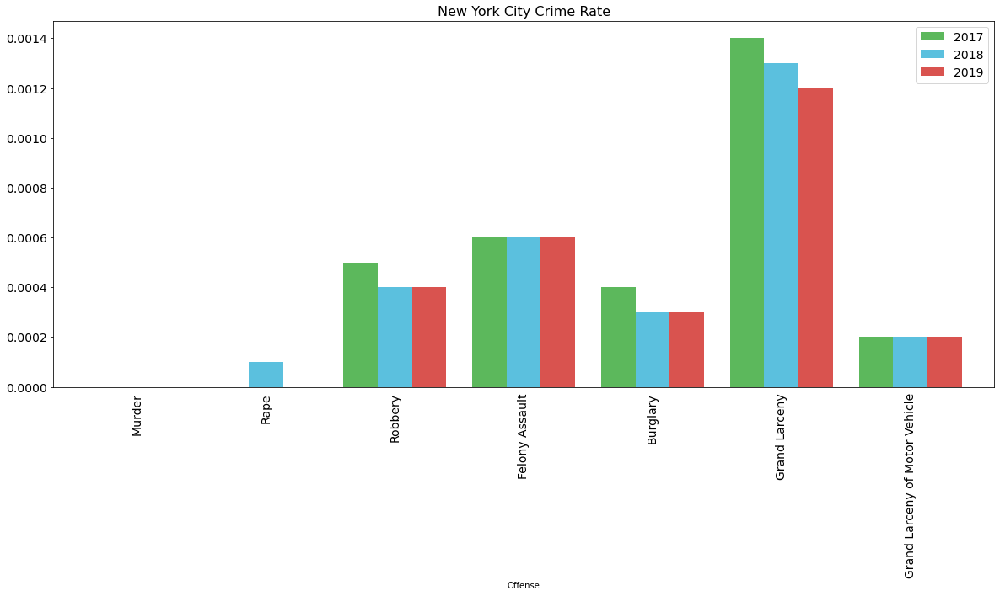

In [169]:

ny_crime.plot(kind='bar', figsize=(20,8), width=0.8, color=['#5cb85c','#5bc0de','#d9534f'], fontsize=14, edgecolor=None)
plt.title('New York City Crime Rate', fontsize=16)
plt.xticks(fontsize=14)
plt.legend(fontsize=14)

plt.show()

In [76]:

#body = client_84e010cfc5ba41019681603aeef5e3f7.get_object(Bucket='datasciencecapstoneassignment-donotdelete-pr-gikxoidxrurhxi',Key='ny_crime.csv')['Body']
# add missing __iter__ method, so pandas accepts body as file-like object
#if not hasattr(body, "__iter__"): body.__iter__ = types.MethodType( __iter__, body )

#ny_crime_perc = pd.read_csv(body)

#ny_crime_perc

,Offense,2017,2018,2019
0,Murder,292,295,319
1,Rape,1449,1794,1755
2,Robbery,15500,12913,13371
3,Felony Assault,20847,20208,20698
4,Burglary,12990,11687,10783
5,Grand Larceny,44279,43558,43250
6,Grand Larceny of Motor Vehicle,6327,5428,5430


In [81]:


ny_crime['2017']=(ny_crime['2017']/8560000*100).round(4)
ny_crime['2018']=(ny_crime['2018']/8440000*100).round(4)
ny_crime['2019']=(ny_crime['2019']/8410000*100).round(4)


ny_crime

,2017,2018,2019
Offense,,,
Murder,0.0034,0.0035,0.0038
Rape,0.0169,0.0213,0.0209
Robbery,0.1811,0.1530,0.1590
Felony Assault,0.2435,0.2394,0.2461
Burglary,0.1518,0.1385,0.1282
Grand Larceny,0.5173,0.5161,0.5143
Grand Larceny of Motor Vehicle,0.0739,0.0643,0.0646


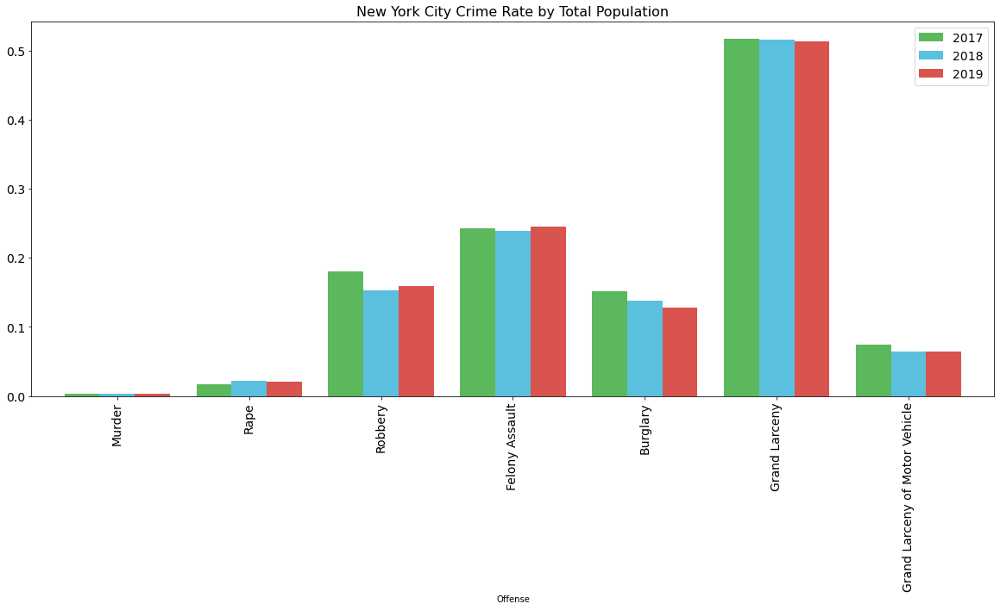

In [82]:

ny_crime.plot(kind='bar', figsize=(20,8), width=0.8, color=['#5cb85c','#5bc0de','#d9534f'], fontsize=14, edgecolor=None)
plt.title('New York City Crime Rate by Total Population', fontsize=16)
plt.xticks(fontsize=14)
plt.legend(fontsize=14)

plt.show()

In [84]:

body = client_84e010cfc5ba41019681603aeef5e3f7.get_object(Bucket='datasciencecapstoneassignment-donotdelete-pr-gikxoidxrurhxi',Key='ny crime total.csv')['Body']
# add missing __iter__ method, so pandas accepts body as file-like object
if not hasattr(body, "__iter__"): body.__iter__ = types.MethodType( __iter__, body )

ny_crime_total = pd.read_csv(body)
ny_crime_total.head()


,Column1,2017,2018,2019
0,rate,1.13,1.14,1.14


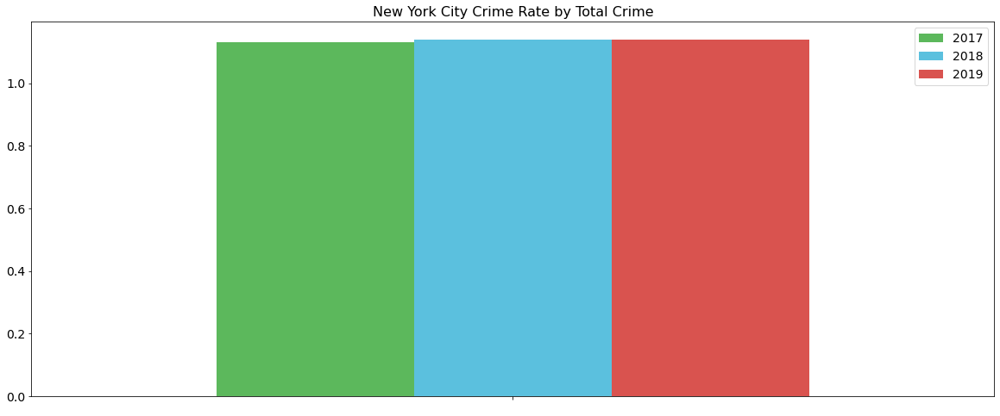

In [90]:
ny_crime_total.plot(kind='bar', figsize=(20,8), width=0.8, color=['#5cb85c','#5bc0de','#d9534f'], fontsize=14, edgecolor=None)
plt.title('New York City Crime Rate by Total Crime', fontsize=16)
plt.xticks(fontsize=14, color='white')
plt.legend(fontsize=14)
plt.plot(range(0,1))

plt.show()

# Toronto

In [103]:
wiki_link='https://en.wikipedia.org/wiki/List_of_postal_codes_of_Canada:_M' #inserting the wiki page link
wiki_data=pd.read_html(wiki_link,header=0)[0] #using pandas to read the table on the wiki page
wiki_data #displaying the table that was pulled from the wiki page

,Postal Code,Borough,Neighbourhood
0,M1A,Not assigned,Not assigned
1,M2A,Not assigned,Not assigned
2,M3A,North York,Parkwoods
3,M4A,North York,Victoria Village
4,M5A,Downtown Toronto,"Regent Park, Harbourfront"
5,M6A,North York,"Lawrence Manor, Lawrence Heights"
6,M7A,Downtown Toronto,"Queen's Park, Ontario Provincial Government"
7,M8A,Not assigned,Not assigned
8,M9A,Etobicoke,"Islington Avenue, Humber Valley Village"
9,M1B,Scarborough,"Malvern, Rouge"


In [104]:
toronto_data= wiki_data[wiki_data.Borough!= "Not assigned"] #droping the rows that contain 'Not assigned'
toronto_data.head()

,Postal Code,Borough,Neighbourhood
2,M3A,North York,Parkwoods
3,M4A,North York,Victoria Village
4,M5A,Downtown Toronto,"Regent Park, Harbourfront"
5,M6A,North York,"Lawrence Manor, Lawrence Heights"
6,M7A,Downtown Toronto,"Queen's Park, Ontario Provincial Government"


In [105]:
geo_link='http://cocl.us/Geospatial_data'
geo_data=pd.read_csv(geo_link)
geo_data.head()

,Postal Code,Latitude,Longitude
0,M1B,43.806686,-79.194353
1,M1C,43.784535,-79.160497
2,M1E,43.763573,-79.188711
3,M1G,43.770992,-79.216917
4,M1H,43.773136,-79.239476


In [106]:
toronto_data = pd.merge(toronto_data,geo_data,on=['Postal Code'])
toronto_data.head()

,Postal Code,Borough,Neighbourhood,Latitude,Longitude
0,M3A,North York,Parkwoods,43.753259,-79.329656
1,M4A,North York,Victoria Village,43.725882,-79.315572
2,M5A,Downtown Toronto,"Regent Park, Harbourfront",43.654260,-79.360636
3,M6A,North York,"Lawrence Manor, Lawrence Heights",43.718518,-79.464763
4,M7A,Downtown Toronto,"Queen's Park, Ontario Provincial Government",43.662301,-79.389494


In [107]:
geolocator = Nominatim(user_agent="ny_explorer")
location = geolocator.geocode('Toronto')
latitude = location.latitude
longitude = location.longitude
print('The geograpical coordinate of Toronto are {}, {}.'.format(latitude, longitude))

The geograpical coordinate of Toronto are 43.6534817, -79.3839347.


In [108]:
map_toronto = folium.Map(location=[latitude, longitude], zoom_start=10)

# add markers to map
for lat, lng, borough, neighborhood in zip(toronto_data['Latitude'], toronto_data['Longitude'], toronto_data['Borough'], toronto_data['Neighbourhood']):
    label = '{}, {}'.format(toronto_data, borough)
    label = folium.Popup(label, parse_html=True)
    folium.CircleMarker(
        [lat, lng],
        radius=5,
        popup=label,
        color='blue',
        fill=True,
        fill_color='#3186cc',
        fill_opacity=0.7,
        parse_html=False).add_to(map_toronto)  
    
map_toronto

In [109]:
toronto_venues=getNearbyVenues(names=table['Neighbourhood'],latitudes=table['Latitude'],
                                longitudes=table['Longitude'])

Parkwoods
Victoria Village
Regent Park, Harbourfront
Lawrence Manor, Lawrence Heights
Queen's Park, Ontario Provincial Government
Islington Avenue, Humber Valley Village
Malvern, Rouge
Don Mills
Parkview Hill, Woodbine Gardens
Garden District, Ryerson
Glencairn
West Deane Park, Princess Gardens, Martin Grove, Islington, Cloverdale
Rouge Hill, Port Union, Highland Creek
Don Mills
Woodbine Heights
St. James Town
Humewood-Cedarvale
Eringate, Bloordale Gardens, Old Burnhamthorpe, Markland Wood
Guildwood, Morningside, West Hill
The Beaches
Berczy Park
Caledonia-Fairbanks
Woburn
Leaside
Central Bay Street
Christie
Cedarbrae
Hillcrest Village
Bathurst Manor, Wilson Heights, Downsview North
Thorncliffe Park
Richmond, Adelaide, King
Dufferin, Dovercourt Village
Scarborough Village
Fairview, Henry Farm, Oriole
Northwood Park, York University
East Toronto, Broadview North (Old East York)
Harbourfront East, Union Station, Toronto Islands
Little Portugal, Trinity
Kennedy Park, Ionview, East Birchmo

In [110]:
print('{} venues were returned by Foursquare.'.format(toronto_venues.shape[0]))
toronto_venues.head()

429 venues were returned by Foursquare.


,Neighbourhood,Neighborhood Latitude,Neighborhood Longitude,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Parkwoods,43.753259,-79.329656,Brookbanks Park,43.751976,-79.332140,Park
1,Parkwoods,43.753259,-79.329656,649 Variety,43.754513,-79.331942,Convenience Store
2,Parkwoods,43.753259,-79.329656,Variety Store,43.751974,-79.333114,Food & Drink Shop
3,Victoria Village,43.725882,-79.315572,Victoria Village Arena,43.723481,-79.315635,Hockey Arena
4,Victoria Village,43.725882,-79.315572,Portugril,43.725819,-79.312785,Portuguese Restaurant


In [111]:
toronto_venues.groupby('Neighbourhood').count()

,Neighborhood Latitude,Neighborhood Longitude,Venue,Venue Latitude,Venue Longitude,Venue Category
Neighbourhood,,,,,,
Agincourt,4,4,4,4,4,4
"Alderwood, Long Branch",5,5,5,5,5,5
"Bathurst Manor, Wilson Heights, Downsview North",5,5,5,5,5,5
Bayview Village,4,4,4,4,4,4
"Bedford Park, Lawrence Manor East",5,5,5,5,5,5
Berczy Park,5,5,5,5,5,5
"Birch Cliff, Cliffside West",4,4,4,4,4,4
"Brockton, Parkdale Village, Exhibition Place",5,5,5,5,5,5
"Business reply mail Processing Centre, South Central Letter Processing Plant Toronto",5,5,5,5,5,5


In [185]:
# one hot encoding
toronto_onehot = pd.get_dummies(toronto_venues[['Venue Category']], prefix="", prefix_sep="")

# add neighborhood column back to dataframe
toronto_onehot['Neighbourhood'] = toronto_venues['Neighbourhood'] 

# move neighborhood column to the first column
fixed_columns = [toronto_onehot.columns[-1]] + list(toronto_onehot.columns[:-1])
toronto_onehot = toronto_onehot[fixed_columns]

toronto_onehot

,Neighbourhood,Airport,Airport Food Court,Airport Lounge,Airport Terminal,American Restaurant,Arts & Crafts Store,Asian Restaurant,Athletics & Sports,Auto Garage,BBQ Joint,Bakery,Bank,Bar,Baseball Field,Basketball Court,Beer Bar,Beer Store,Bookstore,Boutique,Breakfast Spot,Brewery,Bridal Shop,Bubble Tea Shop,Burger Joint,Burrito Place,Bus Line,Bus Station,Bus Stop,Business Service,Café,Caribbean Restaurant,Chinese Restaurant,Clothing Store,Cocktail Bar,Coffee Shop,College Stadium,Comic Shop,Concert Hall,Construction & Landscaping,Convenience Store,Cosmetics Shop,Creperie,Cuban Restaurant,Curling Ice,Dance Studio,Deli / Bodega,Department Store,Dessert Shop,Diner,Discount Store,Distribution Center,Dog Run,Drugstore,Eastern European Restaurant,Electronics Store,Farmers Market,Fast Food Restaurant,Field,Fish & Chips Shop,Fish Market,Flea Market,Food & Drink Shop,Food Truck,Fried Chicken Joint,Furniture / Home Store,Garden,Garden Center,Gastropub,General Entertainment,Golf Course,Greek Restaurant,Grocery Store,Gym,Gym / Fitness Center,Hakka Restaurant,Harbor / Marina,Health Food Store,History Museum,Hockey Arena,Hotel,Ice Cream Shop,Indian Restaurant,Intersection,Italian Restaurant,Japanese Restaurant,Jewelry Store,Korean BBQ Restaurant,Korean Restaurant,Lake,Latin American Restaurant,Liquor Store,Lounge,Massage Studio,Mediterranean Restaurant,Metro Station,Mexican Restaurant,Middle Eastern Restaurant,Mobile Phone Shop,Motel,Movie Theater,Museum,Music Venue,Neighborhood,Noodle House,Organic Grocery,Park,Performing Arts Venue,Pet Store,Pharmacy,Pizza Place,Playground,Plaza,Pool,Portuguese Restaurant,Pub,Ramen Restaurant,Rental Car Location,Restaurant,River,Salon / Barbershop,Sandwich Place,Shopping Mall,Skating Rink,Smoke Shop,Spa,Sporting Goods Shop,Sports Bar,Steakhouse,Supermarket,Supplement Shop,Sushi Restaurant,Swim School,Thai Restaurant,Theme Restaurant,Toy / Game Store,Trail,Truck Stop,Vegetarian / Vegan Restaurant,Vietnamese Restaurant,Warehouse Store,Wings Joint,Women's Store,Yoga Studio
0,Parkwoods,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
1,Parkwoods,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
2,Parkwoods,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
3,Victoria Village,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
4,Victoria Village,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
5,Victoria Village,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
6,Victoria Village,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0

In [186]:
toronto_grouped = toronto_onehot.groupby('Neighbourhood').mean().reset_index()
toronto_grouped

,Neighbourhood,Airport,Airport Food Court,Airport Lounge,Airport Terminal,American Restaurant,Arts & Crafts Store,Asian Restaurant,Athletics & Sports,Auto Garage,BBQ Joint,Bakery,Bank,Bar,Baseball Field,Basketball Court,Beer Bar,Beer Store,Bookstore,Boutique,Breakfast Spot,Brewery,Bridal Shop,Bubble Tea Shop,Burger Joint,Burrito Place,Bus Line,Bus Station,Bus Stop,Business Service,Café,Caribbean Restaurant,Chinese Restaurant,Clothing Store,Cocktail Bar,Coffee Shop,College Stadium,Comic Shop,Concert Hall,Construction & Landscaping,Convenience Store,Cosmetics Shop,Creperie,Cuban Restaurant,Curling Ice,Dance Studio,Deli / Bodega,Department Store,Dessert Shop,Diner,Discount Store,Distribution Center,Dog Run,Drugstore,Eastern European Restaurant,Electronics Store,Farmers Market,Fast Food Restaurant,Field,Fish & Chips Shop,Fish Market,Flea Market,Food & Drink Shop,Food Truck,Fried Chicken Joint,Furniture / Home Store,Garden,Garden Center,Gastropub,General Entertainment,Golf Course,Greek Restaurant,Grocery Store,Gym,Gym / Fitness Center,Hakka Restaurant,Harbor / Marina,Health Food Store,History Museum,Hockey Arena,Hotel,Ice Cream Shop,Indian Restaurant,Intersection,Italian Restaurant,Japanese Restaurant,Jewelry Store,Korean BBQ Restaurant,Korean Restaurant,Lake,Latin American Restaurant,Liquor Store,Lounge,Massage Studio,Mediterranean Restaurant,Metro Station,Mexican Restaurant,Middle Eastern Restaurant,Mobile Phone Shop,Motel,Movie Theater,Museum,Music Venue,Neighborhood,Noodle House,Organic Grocery,Park,Performing Arts Venue,Pet Store,Pharmacy,Pizza Place,Playground,Plaza,Pool,Portuguese Restaurant,Pub,Ramen Restaurant,Rental Car Location,Restaurant,River,Salon / Barbershop,Sandwich Place,Shopping Mall,Skating Rink,Smoke Shop,Spa,Sporting Goods Shop,Sports Bar,Steakhouse,Supermarket,Supplement Shop,Sushi Restaurant,Swim School,Thai Restaurant,Theme Restaurant,Toy / Game Store,Trail,Truck Stop,Vegetarian / Vegan Restaurant,Vietnamese Restaurant,Warehouse Store,Wings Joint,Women's Store,Yoga Studio
0,Agincourt,0.0000,0.0,0.0,0.0,0.000000,0.0,0.0,0.0000,0.0,0.0,0.0,0.0000,0.0,0.0000,0.0,0.0,0.0,0.0,0.0,0.25,0.0,0.0,0.0,0.0,0.0,0.00,0.0,0.0000,0.00,0.00,0.0,0.25,0.0,0.0,0.000000,0.00,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0000,0.0,0.00,0.0,0.0,0.0000,0.0,0.0,0.00,0.0,0.0,0.0,0.000000,0.0000,0.0,0.0,0.0,0.0,0.0,0.00,0.0,0.0,0.0000,0.0,0.0000,0.0,0.0,0.00,0.0,0.00,0.0,0.0,0.0,0.000000,0.0,0.00,0.00,0.000000,0.0,0.0,0.25,0.0000,0.25,0.0,0.0,0.000000,0.0,0.0,0.00,0.000000,0.0,0.0,0.0,0.00,0.0,0.0,0.000000,0.0,0.0,0.0,0.00,0.000000,0.0,0.0,0.0,0.00,0.0,0.0,0.0,0.0,0.0,0.00,0.0000,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.00,0.00,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.000000,0.0
1,"Alderwood, Long Branch",0.0000,0.0,0.0,0.0,0.000000,0.0,0.0,0.0000,0.0,0.0,0.0,0.0000,0.0,0.0000,0.0,0.0,0.0,0.0,0.0,0.00,0.0,0.0,0.0,0.0,0.0,0.00,0.0,0.0000,0.00,0.00,0.0,0.00,0.0,0.0,0.200000,0.00,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0000,0.0,0.00,0.0,0.0,0.0000,0.0,0.0,0.00,0.0,0.0,0.0,0.000000,0.0000,0.0,0.0,0.0,0.0,0.0,0.00,0.0,0.0,0.0000,0.2,0.0000,0.0,0.0,0.00,0.0,0.00,0.0,0.0,0.0,0.000000,0.0,0.00,0.00,0.000000,0.0,0.0,0.00,0.0000,0.00,0.0,0.0,0.000000,0.0,0.0,0.00,0.000000,0.0,0.0,0.0,0.00,0.0,0.0,0.000000,0.0,0.0,0.0,0.40,0.000000,0.0,0.0,0.0,0.20,0.0,0.0,0.0,0.0,0.0,0.00,0.0000,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.00,0.00,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.000000,0.0
2,"Bathurst Manor, Wilson Heights, Downsview North",0.0000,0.0,0.0,0.0,0.000000,0.0,0.0,0.0000,0.0,0.0,0.0,0.0000,0.0,0.0000,0.0,0.0,0.0,0.0,0.0,0.00,0.0,0.2,0.0,0.0,0.0,0.00,0.0,0.0000,0.00,0.00,0.0,0.00,0.0,0.0,0.200000,0.00,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.2,0.0,0.0,0.0,0.0000,0.0,0.00,0.0,0.0,0.0000,0.0,0.0,0.00,0.0,0.0,0.0,0.000000,0.0000,0.0,0.0,0.0,0.0,0.0,0.00,0.0,0.0,0.0000,0.0,0.0000,0.0,0.0,0.00,0.0,0.00,0.0,0.0,0.0,0.000000,0.0,0.00,0.00,0.000000,0.0,0.0,0.00,0.0000,0.00,0.0,0.0,0.000000,0.0,0.2,0.00,0.000000,0.0,0.0

In [187]:
num_top_venues = 5

for hood in toronto_grouped['Neighbourhood']:
    print("----"+hood+"----")
    temp = toronto_grouped[toronto_grouped['Neighbourhood'] == hood].T.reset_index()
    temp.columns = ['venue','freq']
    temp = temp.iloc[1:]
    temp['freq'] = temp['freq'].astype(float)
    temp = temp.round({'freq': 2})
    print(temp.sort_values('freq', ascending=False).reset_index(drop=True).head(num_top_venues))
    print('\n')

----Agincourt----
                       venue  freq
0                     Lounge  0.25
1  Latin American Restaurant  0.25
2         Chinese Restaurant  0.25
3             Breakfast Spot  0.25
4                      Motel  0.00


----Alderwood, Long Branch----
           venue  freq
0    Pizza Place   0.4
1            Pub   0.2
2            Gym   0.2
3    Coffee Shop   0.2
4  Movie Theater   0.0


----Bathurst Manor, Wilson Heights, Downsview North----
                       venue  freq
0                 Restaurant   0.2
1                Bridal Shop   0.2
2                Coffee Shop   0.2
3  Middle Eastern Restaurant   0.2
4              Deli / Bodega   0.2


----Bayview Village----
                 venue  freq
0                 Bank  0.25
1   Chinese Restaurant  0.25
2                 Café  0.25
3  Japanese Restaurant  0.25
4              Airport  0.00


----Bedford Park, Lawrence Manor East----
                venue  freq
0  Italian Restaurant   0.2
1          Restaurant   0.2
2    

In [188]:
def return_most_common_venues(row, num_top_venues):
    row_categories = row.iloc[1:]
    row_categories_sorted = row_categories.sort_values(ascending=False)
    
    return row_categories_sorted.index.values[0:num_top_venues]

In [189]:
num_top_venues = 10

indicators = ['st', 'nd', 'rd']

# create columns according to number of top venues
columns = ['Neighbourhood']
for ind in np.arange(num_top_venues):
    try:
        columns.append('{}{} Most Common Venue'.format(ind+1, indicators[ind]))
    except:
        columns.append('{}th Most Common Venue'.format(ind+1))

# create a new dataframe
neighborhoods_venues_sorted = pd.DataFrame(columns=columns)
neighborhoods_venues_sorted['Neighbourhood'] = toronto_grouped['Neighbourhood']

for ind in np.arange(toronto_grouped.shape[0]):
    neighborhoods_venues_sorted.iloc[ind, 1:] = return_most_common_venues(toronto_grouped.iloc[ind, :], num_top_venues)

neighborhoods_venues_sorted.head()

,Neighbourhood,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue
0,Agincourt,Breakfast Spot,Lounge,Chinese Restaurant,Latin American Restaurant,Deli / Bodega,Distribution Center,Discount Store,Diner,Dessert Shop,Department Store
1,"Alderwood, Long Branch",Pizza Place,Coffee Shop,Pub,Gym,Diner,Dessert Shop,Department Store,Deli / Bodega,Dance Studio,Curling Ice
2,"Bathurst Manor, Wilson Heights, Downsview North",Coffee Shop,Deli / Bodega,Bridal Shop,Restaurant,Middle Eastern Restaurant,Cosmetics Shop,Creperie,Cuban Restaurant,Curling Ice,Distribution Center
3,Bayview Village,Japanese Restaurant,Chinese Restaurant,Café,Bank,Yoga Studio,Department Store,Distribution Center,Discount Store,Diner,Dessert Shop
4,"Bedford Park, Lawrence Manor East",Restaurant,Italian Restaurant,Café,Indian Restaurant,Sushi Restaurant,Yoga Studio,Deli / Bodega,Diner,Dessert Shop,Department Store


In [190]:
# set number of clusters
kclusters = 5

toronto_grouped_clustering = toronto_grouped.drop('Neighbourhood', 1)

# run k-means clustering
kmeans = KMeans(n_clusters=kclusters, random_state=0).fit(toronto_grouped_clustering)

# check cluster labels generated for each row in the dataframe
kmeans.labels_[0:10] 

array([0, 1, 2, 0, 0, 0, 0, 2, 1, 0], dtype=int32)

In [191]:
# add clustering labels
neighborhoods_venues_sorted.insert(0, 'Cluster Labels', kmeans.labels_)

toronto_merged = table

# merge toronto_grouped with toronto_data to add latitude/longitude for each neighborhood
print('{} venues were returned by Foursquare.'.format(toronto_venues.shape[0]))
toronto_merged = toronto_merged.join(neighborhoods_venues_sorted.set_index('Neighbourhood'), on='Neighbourhood')

toronto_merged.head() 

429 venues were returned by Foursquare.


,Postal Code,Borough,Neighbourhood,Latitude,Longitude,Cluster Labels,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue
0,M3A,North York,Parkwoods,43.753259,-79.329656,3.0,Park,Convenience Store,Food & Drink Shop,Concert Hall,Construction & Landscaping,Comic Shop,Cosmetics Shop,Creperie,Cuban Restaurant,Dog Run
1,M4A,North York,Victoria Village,43.725882,-79.315572,1.0,Coffee Shop,Pizza Place,Intersection,Hockey Arena,Portuguese Restaurant,Construction & Landscaping,Convenience Store,Cosmetics Shop,Creperie,Concert Hall
2,M5A,Downtown Toronto,"Regent Park, Harbourfront",43.654260,-79.360636,2.0,Coffee Shop,Bakery,Spa,Restaurant,Distribution Center,Convenience Store,Cosmetics Shop,Creperie,Cuban Restaurant,Curling Ice
3,M6A,North York,"Lawrence Manor, Lawrence Heights",43.718518,-79.464763,2.0,Coffee Shop,Clothing Store,Vietnamese Restaurant,Furniture / Home Store,Boutique,Deli / Bodega,Distribution Center,Discount Store,Diner,Dessert Shop
4,M7A,Downtown Toronto,"Queen's Park, Ontario Provincial Government",43.662301,-79.389494,2.0,Coffee Shop,Portuguese Restaurant,Italian Restaurant,Distribution Center,Park,Convenience Store,Cosmetics Shop,Creperie,Construction & Landscaping,Concert Hall


In [119]:
# create map
map_clusters = folium.Map(location=[latitude, longitude], zoom_start=11)

# set color scheme for the clusters
x = np.arange(kclusters)
ys = [i + x + (i*x)**2 for i in range(kclusters)]
colors_array = cm.rainbow(np.linspace(0, 1, len(ys)))
rainbow = [colors.rgb2hex(i) for i in colors_array]

# add markers to the map
markers_colors = []
for lat, lon, poi, cluster in zip(toronto_merged['Latitude'], toronto_merged['Longitude'], toronto_merged['Neighbourhood'], toronto_merged['Cluster Labels']):
    label = folium.Popup(str(poi) + ' Cluster ' + str(cluster), parse_html=True)
    folium.CircleMarker(
        [lat, lon],
        radius=5,
        popup=label,
        color='red',
        fill=True,
        fill_color='red',
        fill_opacity=0.7).add_to(map_clusters)
       
map_clusters

In [141]:

body = client_84e010cfc5ba41019681603aeef5e3f7.get_object(Bucket='datasciencecapstoneassignment-donotdelete-pr-gikxoidxrurhxi',Key='t_crime.csv')['Body']
# add missing __iter__ method, so pandas accepts body as file-like object
if not hasattr(body, "__iter__"): body.__iter__ = types.MethodType( __iter__, body )

t_crime = pd.read_csv(body)
t_crime.head()


,Offense,2017,2018,2019
0,Murder,65,97,79
1,Rape,2516,2849,2833
2,Robbery,4098,3754,3725
3,Felony Assault,19292,19922,21093
4,Burglary,6933,7614,8551


In [145]:
#t_crime.rename(columns={'Offense':'Offense'},inplace=True)
t_crime.set_index('Offense',inplace=True)
t_crime

,2017,2018,2019
Offense,,,
Murder,65,97,79
Rape,2516,2849,2833
Robbery,4098,3754,3725
Felony Assault,19292,19922,21093
Burglary,6933,7614,8551
Grand Larceny,1191,1260,1401
Grand Larceny of Motor Vehicle,3583,4781,5322


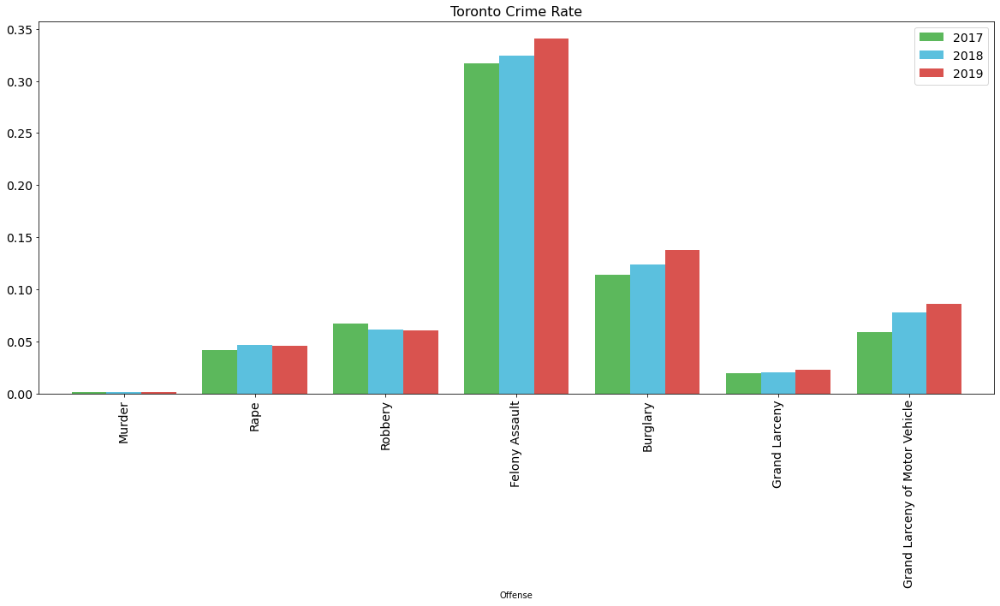

In [168]:

t_crime.plot(kind='bar', figsize=(20,8), width=0.8, color=['#5cb85c','#5bc0de','#d9534f'], fontsize=14, edgecolor=None)
plt.title('Toronto Crime Rate', fontsize=16)
plt.xticks(fontsize=14)
plt.legend(fontsize=14)

plt.show()

In [147]:
t_crime['2017']=(t_crime['2017']/6082000*100).round(4)
t_crime['2018']=(t_crime['2018']/6139000*100).round(4)
t_crime['2019']=(t_crime['2019']/6197000*100).round(4)

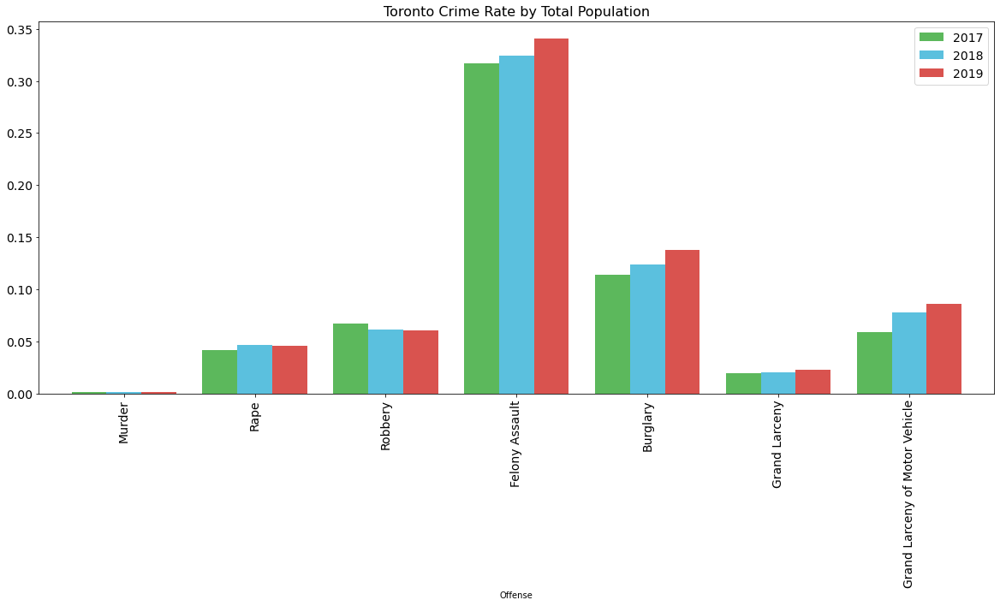

In [167]:
t_crime.plot(kind='bar', figsize=(20,8), width=0.8, color=['#5cb85c','#5bc0de','#d9534f'], fontsize=14, edgecolor=None)
plt.title('Toronto Crime Rate by Total Population', fontsize=16)
plt.xticks(fontsize=14)
plt.legend(fontsize=14)

plt.show()


In [149]:

body = client_84e010cfc5ba41019681603aeef5e3f7.get_object(Bucket='datasciencecapstoneassignment-donotdelete-pr-gikxoidxrurhxi',Key='t crime total.csv')['Body']
# add missing __iter__ method, so pandas accepts body as file-like object
if not hasattr(body, "__iter__"): body.__iter__ = types.MethodType( __iter__, body )

t_crime_total = pd.read_csv(body)
t_crime_total.head()


,Column1,2017,2018,2019
0,rate,0.62,0.66,0.69


<function matplotlib.pyplot.show(*args, **kw)>

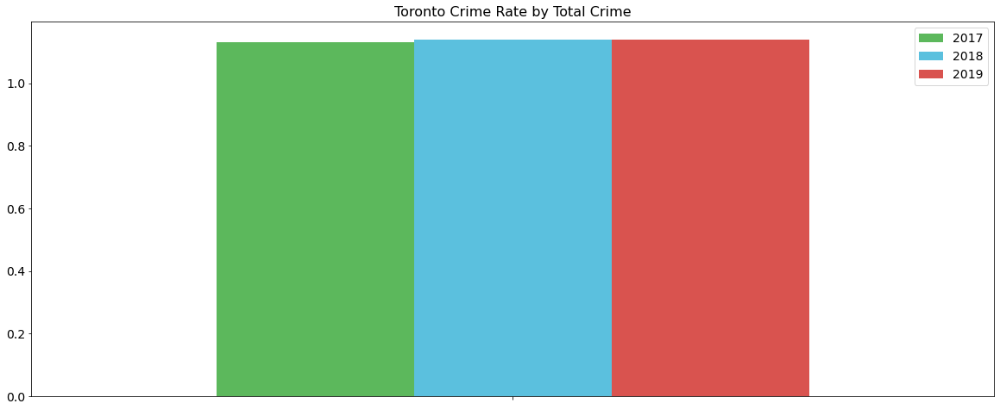

In [166]:
ny_crime_total.plot(kind='bar', figsize=(20,8), width=0.8, color=['#5cb85c','#5bc0de','#d9534f'], fontsize=14, edgecolor=None)
plt.title('Toronto Crime Rate by Total Crime', fontsize=16)
plt.xticks(fontsize=14, color='white')
plt.legend(fontsize=14)

#plt.plot(float(range(0,0.7))

plt.show